<a href="https://colab.research.google.com/github/Avishek-Majumder/Morphological-operation-for-single-image-and-dataset/blob/main/Morphological_operation_for_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

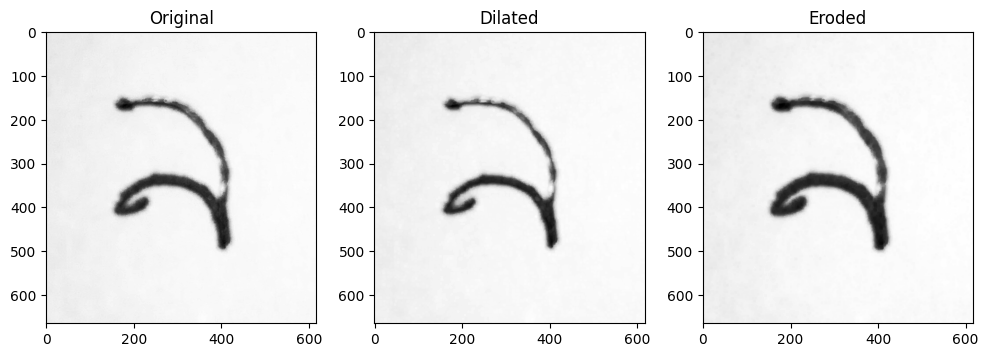

<ipython-input-1-74eaddbdbfdd>:39: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  zip_file.writestr(f"{file_name}_original.png", cv2.imencode(".png", image)[1].tostring())
<ipython-input-1-74eaddbdbfdd>:40: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  zip_file.writestr(f"{file_name}_dilated.png", cv2.imencode(".png", dilated_image)[1].tostring())
<ipython-input-1-74eaddbdbfdd>:41: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  zip_file.writestr(f"{file_name}_eroded.png", cv2.imencode(".png", eroded_image)[1].tostring())


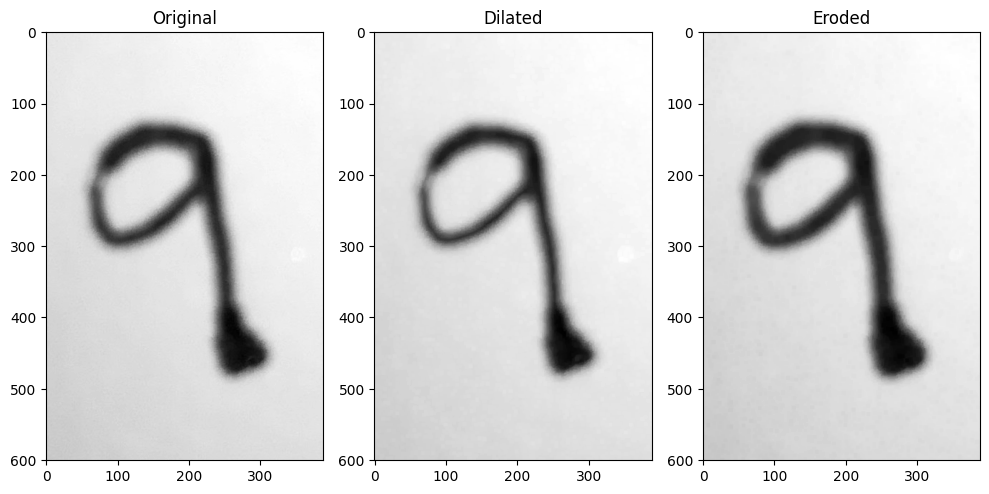

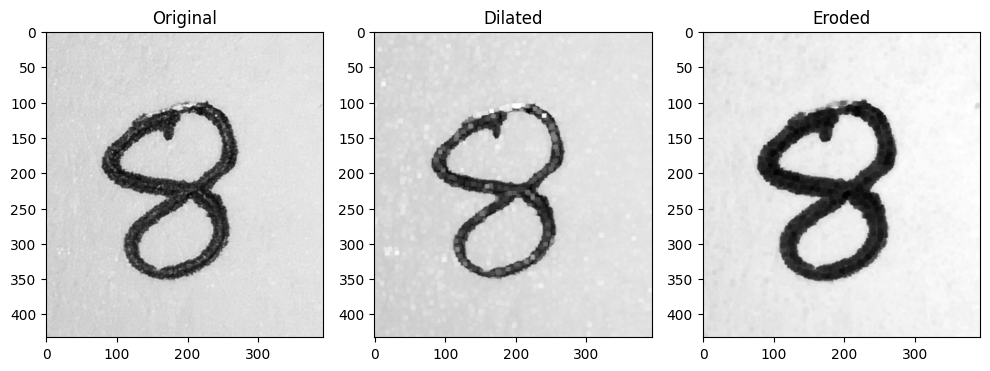

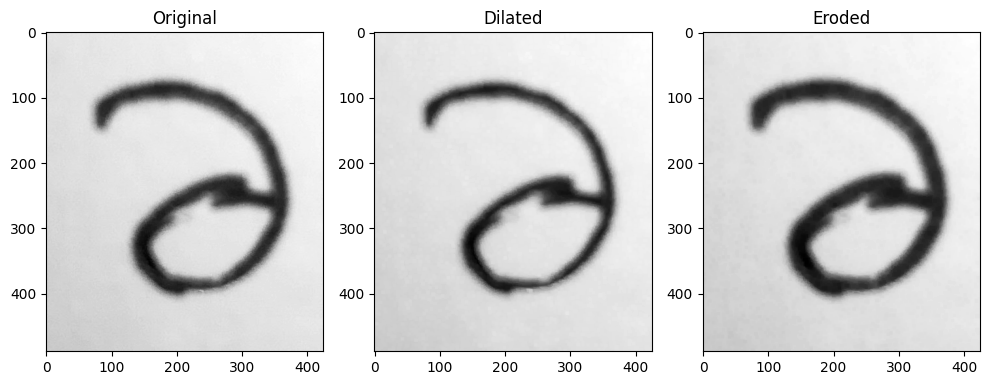

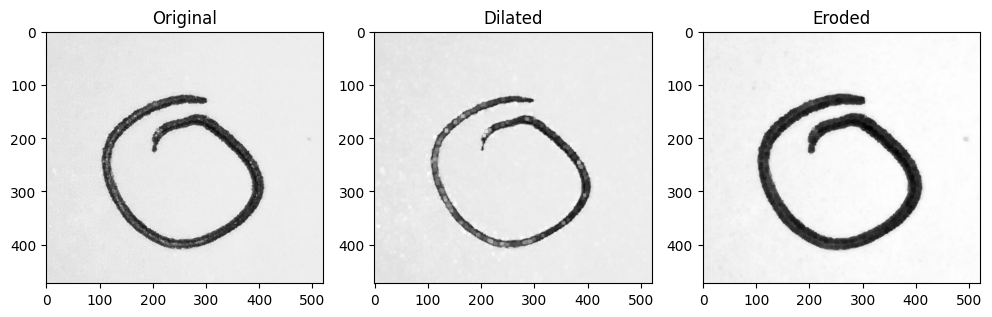

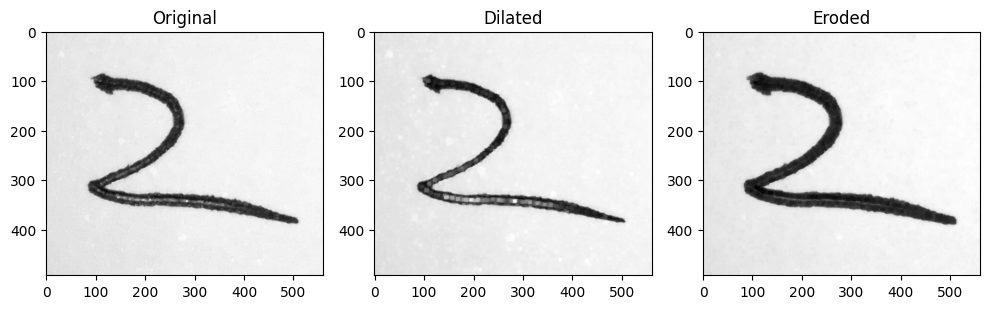

...

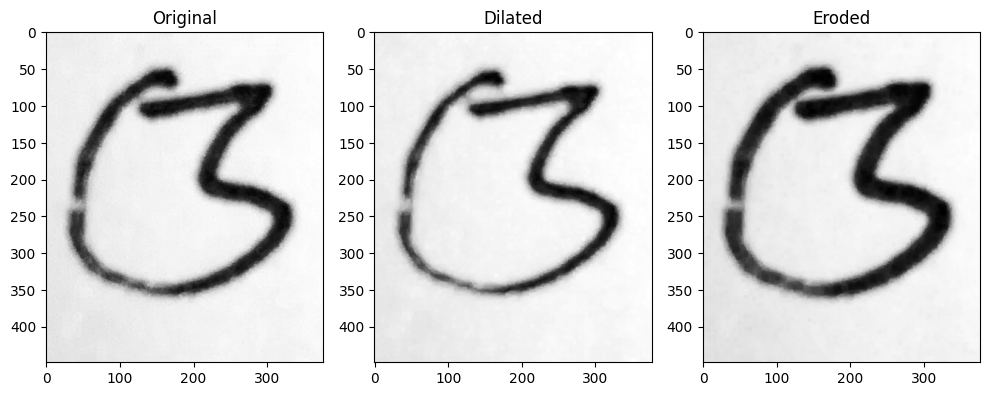

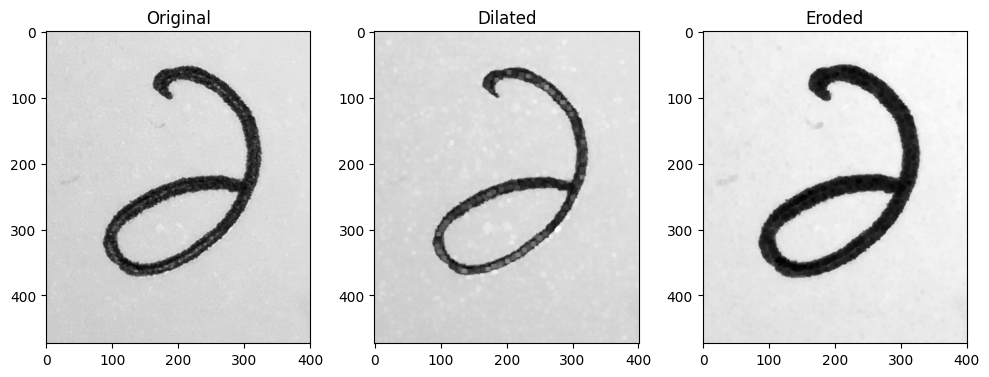

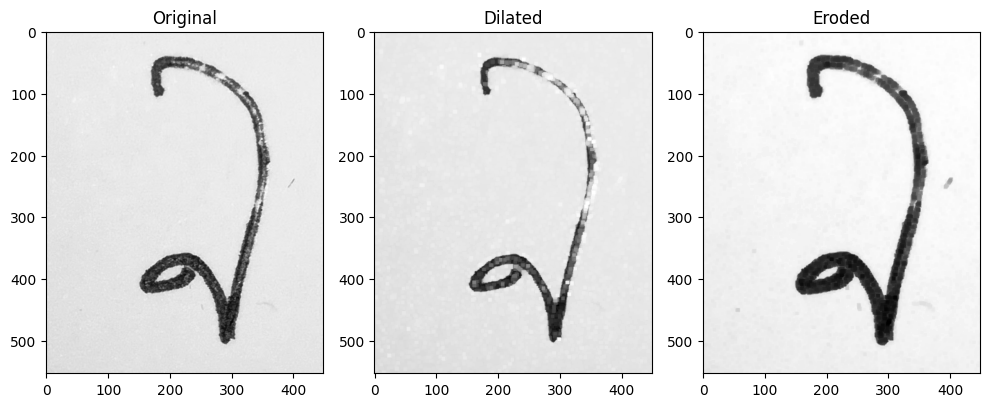

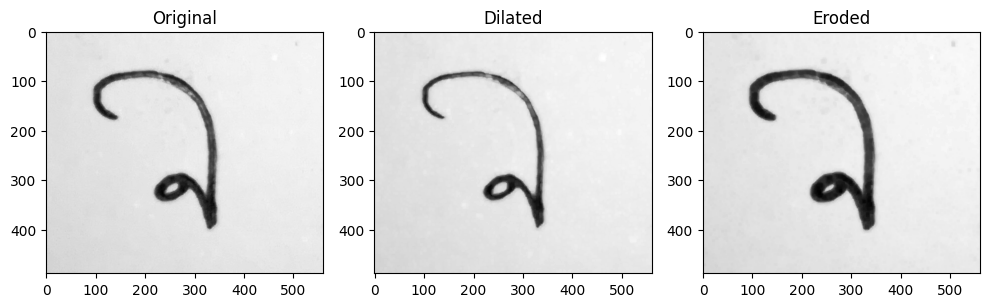

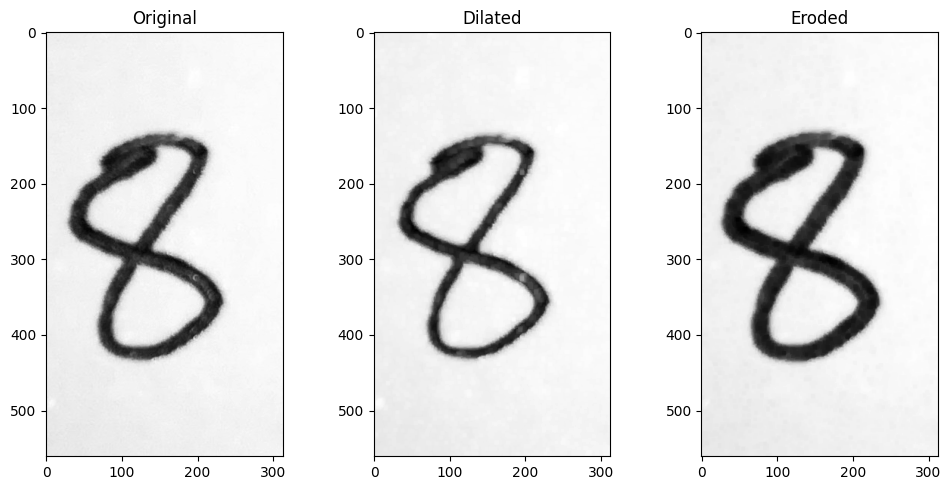

Processed images zipped.


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
import cv2
import numpy as np
import zipfile
import os
from matplotlib import pyplot as plt
from google.colab import files

# Set the path to the folder containing the images
folder_path = "/content/drive/MyDrive/Bangla Handwritten Digits Dataset"

# Create a zip file to store the processed images
zip_file = zipfile.ZipFile("/content/drive/MyDrive/processed_images.zip", "w")

# Get a list of all image files in the folder
image_files = [f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.png'))]

# Perform morphological operations on each image and add them to the zip file
for file_name in image_files:
    # Load the image
    image_path = os.path.join(folder_path, file_name)
    image = cv2.imread(image_path, 0)  # Read the image as grayscale

    # Perform morphological operation
    kernel = np.ones((5, 5), np.uint8)  # Define the kernel for morphological operation
    # Perform dilation
    dilated_image = cv2.dilate(image, kernel, iterations=1)
    # Perform erosion
    eroded_image = cv2.erode(image, kernel, iterations=1)

    # Display the original and processed images
    plt.figure(figsize=(10, 5))
    plt.subplot(131), plt.imshow(image, cmap="gray"), plt.title("Original")
    plt.subplot(132), plt.imshow(dilated_image, cmap="gray"), plt.title("Dilated")
    plt.subplot(133), plt.imshow(eroded_image, cmap="gray"), plt.title("Eroded")
    plt.tight_layout()
    plt.show()

    # Add the processed images to the zip file
    zip_file.writestr(f"{file_name}_original.png", cv2.imencode(".png", image)[1].tostring())
    zip_file.writestr(f"{file_name}_dilated.png", cv2.imencode(".png", dilated_image)[1].tostring())
    zip_file.writestr(f"{file_name}_eroded.png", cv2.imencode(".png", eroded_image)[1].tostring())

# Close the zip file
zip_file.close()

# Provide the zip file for download
print("Processed images zipped.")

# Download the zip file
files.download("/content/drive/MyDrive/processed_images.zip")
